# PUBG - PLAYER UNKNOWN'S BATTLEGROUND

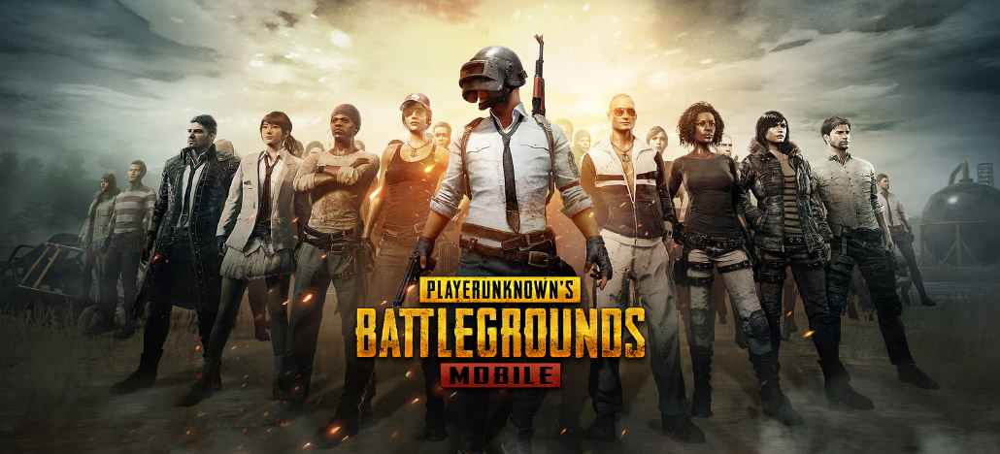

### The official PLAYER UNKNOWN'S BATTLEGROUNDS designed exclusively for mobile. Play free anywhere, anytime. PUBG MOBILE delivers the most intense free-to-play multiplayer action on mobile. Drop in, gear up, and compete. Survive epic 100-player classic battles, payload mode and fast-paced 4v4 team deathmatch and zombie modes. Survival is key and the last one standing wins. When duty calls, fire at will!

1. FREE ON MOBILE - Powered by the Unreal Engine 4. Play console quality gaming on the go. Delivers jaw-dropping HD graphics and 3D sound. Featuring customizable mobile controls, training modes, and voice chat. Experience the most smooth control and realistic ballistics, weapon behavior on mobile.

2. MASSIVE BATTLE MAPS - From Erangel to Miramar, Vikendi to Sanhok, compete on these enormous and detailed battlegrounds varying in size, terrain, day/night cycles and dynamic weather – from urban city spaces to frozen tundra, to dense jungles, master each battleground's secrets to create your own strategic approach to win.

3. DEPTH AND VARIETY – From the 100-player classic mode, the exhilarating payload mode to the lightning-fast Arcade and 4v4 Team Deathmatch modes, as well as the intense Zombie modes. There is something for everyone! There is something for everyone. Play Solo, Duo, and in 4-player Squads. Fire your weapon to your heart's content! Be a lone wolf soldier or play with a Clan and answer the duty calls when help is needed! Offers FPS (First-Person Shooter) and TPS (Third-Person Shooter) play, lots of vehicles for all the different terrains in the game and an arsenal of realistic weapons. Find your perfect ride and pieces to cruise towards the final circle!

# Importing necessary Libraries

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns

import warnings
warnings.filterwarnings('ignore')

import plotly
import plotly.express as px
import plotly.offline as pyo
import cufflinks as cf
from plotly.offline import init_notebook_mode,plot,iplot

pyo.init_notebook_mode(connected=True)
cf.go_offline()

In [2]:
import plotly.graph_objects as go

In [26]:
fig = px.colors.qualitative.swatches()
fig.show()

# Loading Data and some insights

In [39]:
df = pd.read_csv(r'E:\Machine Learning datasets\Pubg stats\PUBG.csv')
print(df.info())
print('-'*100)
print(df.describe())
print('-'*100)
print("The shape of the data is : ", df.shape)
print('-'*100)
df.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 87898 entries, 0 to 87897
Columns: 152 entries, player_name to squad_DBNOs
dtypes: float64(83), int64(68), object(1)
memory usage: 101.9+ MB
None
----------------------------------------------------------------------------------------------------
          tracker_id  solo_KillDeathRatio  solo_WinRatio  solo_TimeSurvived  \
count   87898.000000         87898.000000   87898.000000       8.789800e+04   
mean   110794.357050             1.865855       5.017506       6.971571e+04   
std     63648.581759             1.776301      10.077138       8.040861e+04   
min         0.000000             0.000000       0.000000       7.610000e+01   
25%     51925.250000             1.030000       0.000000       1.789705e+04   
50%    112705.500000             1.470000       2.000000       4.517333e+04   
75%    164879.750000             2.140000       5.560000       9.246264e+04   
max    222490.000000           100.000000     100.000000       1.521200

,player_name,tracker_id,solo_KillDeathRatio,solo_WinRatio,solo_TimeSurvived,solo_RoundsPlayed,solo_Wins,solo_WinTop10Ratio,solo_Top10s,solo_Top10Ratio,...,squad_RideDistance,squad_MoveDistance,squad_AvgWalkDistance,squad_AvgRideDistance,squad_LongestKill,squad_Heals,squad_Revives,squad_Boosts,squad_DamageDealt,squad_DBNOs
0,BreakNeck,4405,3.14,17.65,18469.14,17,3,0.83,4,23.5,...,3751590.99,5194786.58,2626.97,4372.64,536.98,2186,234,1884,242132.73,1448
1,Blackwalk,8199,4.41,18.18,33014.86,33,6,0.36,11,33.3,...,4295917.30,6051783.67,2422.48,6009.73,734.85,2041,276,2340,269795.75,1724
2,mercedes_benz,4454,3.60,0.00,4330.44,5,0,0.00,1,20.0,...,3935265.63,5589608.74,1871.89,3011.87,725.44,1766,210,2193,292977.07,1897
3,DORA,7729,14.00,50.00,13421.82,8,4,0.67,6,75.0,...,2738998.00,3796916.00,2154.62,5578.41,587.28,1214,142,1252,181106.90,1057
4,n2tstar,0,10.50,33.33,9841.04,6,2,0.40,5,83.3,...,2347295.00,3220260.00,2098.47,5642.54,546.10,1245,120,923,160029.80,1077


In [40]:
solo_columns = []
for i in df.columns:
    if "solo" in i:
        solo_columns.append(i)

In [41]:
solo_columns

['solo_KillDeathRatio',
 'solo_WinRatio',
 'solo_TimeSurvived',
 'solo_RoundsPlayed',
 'solo_Wins',
 'solo_WinTop10Ratio',
 'solo_Top10s',
 'solo_Top10Ratio',
 'solo_Losses',
 'solo_Rating',
 'solo_BestRating',
 'solo_DamagePg',
 'solo_HeadshotKillsPg',
 'solo_HealsPg',
 'solo_KillsPg',
 'solo_MoveDistancePg',
 'solo_RevivesPg',
 'solo_RoadKillsPg',
 'solo_TeamKillsPg',
 'solo_TimeSurvivedPg',
 'solo_Top10sPg',
 'solo_Kills',
 'solo_Assists',
 'solo_Suicides',
 'solo_TeamKills',
 'solo_HeadshotKills',
 'solo_HeadshotKillRatio',
 'solo_VehicleDestroys',
 'solo_RoadKills',
 'solo_DailyKills',
 'solo_WeeklyKills',
 'solo_RoundMostKills',
 'solo_MaxKillStreaks',
 'solo_WeaponAcquired',
 'solo_Days',
 'solo_LongestTimeSurvived',
 'solo_MostSurvivalTime',
 'solo_AvgSurvivalTime',
 'solo_WinPoints',
 'solo_WalkDistance',
 'solo_RideDistance',
 'solo_MoveDistance',
 'solo_AvgWalkDistance',
 'solo_AvgRideDistance',
 'solo_LongestKill',
 'solo_Heals',
 'solo_Revives',
 'solo_Boosts',
 'solo_Dama

In [42]:
df_solo = df[solo_columns].copy()

In [8]:
print(df_solo.info())
print('-'*100)
print(df_solo.describe())
print('-'*100)
print("The shape of the data is : ", df_solo.shape)
print('-'*100)
df_solo.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 87898 entries, 0 to 87897
Data columns (total 50 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   solo_KillDeathRatio       87898 non-null  float64
 1   solo_WinRatio             87898 non-null  float64
 2   solo_TimeSurvived         87898 non-null  float64
 3   solo_RoundsPlayed         87898 non-null  int64  
 4   solo_Wins                 87898 non-null  int64  
 5   solo_WinTop10Ratio        87898 non-null  float64
 6   solo_Top10s               87898 non-null  int64  
 7   solo_Top10Ratio           87898 non-null  float64
 8   solo_Losses               87898 non-null  int64  
 9   solo_Rating               87898 non-null  float64
 10  solo_BestRating           87898 non-null  float64
 11  solo_DamagePg             87898 non-null  float64
 12  solo_HeadshotKillsPg      87898 non-null  float64
 13  solo_HealsPg              87898 non-null  float64
 14  solo_K

,solo_KillDeathRatio,solo_WinRatio,solo_TimeSurvived,solo_RoundsPlayed,solo_Wins,solo_WinTop10Ratio,solo_Top10s,solo_Top10Ratio,solo_Losses,solo_Rating,...,solo_RideDistance,solo_MoveDistance,solo_AvgWalkDistance,solo_AvgRideDistance,solo_LongestKill,solo_Heals,solo_Revives,solo_Boosts,solo_DamageDealt,solo_DBNOs
0,3.14,17.65,18469.14,17,3,0.83,4,23.5,14,1559.78,...,27537.53,56461.84,2202.40,2764.50,304.87,33,0,29,4341.06,0
1,4.41,18.18,33014.86,33,6,0.36,11,33.3,27,1884.53,...,117837.74,165706.51,2017.38,5188.69,351.95,60,0,88,12970.39,0
2,3.60,0.00,4330.44,5,0,0.00,1,20.0,5,1255.92,...,7683.20,14023.99,1375.70,3052.50,125.76,5,0,3,1648.82,0
3,14.00,50.00,13421.82,8,4,0.67,6,75.0,4,1798.70,...,30314.83,47894.53,2197.46,3789.35,412.25,8,0,24,6015.57,0
4,10.50,33.33,9841.04,6,2,0.40,5,83.3,4,1668.67,...,22425.36,39161.77,2789.40,3737.56,307.97,12,0,21,3824.89,0


# Solo EDA

In [11]:
solo_columns

['solo_KillDeathRatio',
 'solo_WinRatio',
 'solo_TimeSurvived',
 'solo_RoundsPlayed',
 'solo_Wins',
 'solo_WinTop10Ratio',
 'solo_Top10s',
 'solo_Top10Ratio',
 'solo_Losses',
 'solo_Rating',
 'solo_BestRating',
 'solo_DamagePg',
 'solo_HeadshotKillsPg',
 'solo_HealsPg',
 'solo_KillsPg',
 'solo_MoveDistancePg',
 'solo_RevivesPg',
 'solo_RoadKillsPg',
 'solo_TeamKillsPg',
 'solo_TimeSurvivedPg',
 'solo_Top10sPg',
 'solo_Kills',
 'solo_Assists',
 'solo_Suicides',
 'solo_TeamKills',
 'solo_HeadshotKills',
 'solo_HeadshotKillRatio',
 'solo_VehicleDestroys',
 'solo_RoadKills',
 'solo_DailyKills',
 'solo_WeeklyKills',
 'solo_RoundMostKills',
 'solo_MaxKillStreaks',
 'solo_WeaponAcquired',
 'solo_Days',
 'solo_LongestTimeSurvived',
 'solo_MostSurvivalTime',
 'solo_AvgSurvivalTime',
 'solo_WinPoints',
 'solo_WalkDistance',
 'solo_RideDistance',
 'solo_MoveDistance',
 'solo_AvgWalkDistance',
 'solo_AvgRideDistance',
 'solo_LongestKill',
 'solo_Heals',
 'solo_Revives',
 'solo_Boosts',
 'solo_Dama

In [12]:
df_solo.head()

,solo_KillDeathRatio,solo_WinRatio,solo_TimeSurvived,solo_RoundsPlayed,solo_Wins,solo_WinTop10Ratio,solo_Top10s,solo_Top10Ratio,solo_Losses,solo_Rating,...,solo_RideDistance,solo_MoveDistance,solo_AvgWalkDistance,solo_AvgRideDistance,solo_LongestKill,solo_Heals,solo_Revives,solo_Boosts,solo_DamageDealt,solo_DBNOs
0,3.14,17.65,18469.14,17,3,0.83,4,23.5,14,1559.78,...,27537.53,56461.84,2202.40,2764.50,304.87,33,0,29,4341.06,0
1,4.41,18.18,33014.86,33,6,0.36,11,33.3,27,1884.53,...,117837.74,165706.51,2017.38,5188.69,351.95,60,0,88,12970.39,0
2,3.60,0.00,4330.44,5,0,0.00,1,20.0,5,1255.92,...,7683.20,14023.99,1375.70,3052.50,125.76,5,0,3,1648.82,0
3,14.00,50.00,13421.82,8,4,0.67,6,75.0,4,1798.70,...,30314.83,47894.53,2197.46,3789.35,412.25,8,0,24,6015.57,0
4,10.50,33.33,9841.04,6,2,0.40,5,83.3,4,1668.67,...,22425.36,39161.77,2789.40,3737.56,307.97,12,0,21,3824.89,0


In [16]:
px.histogram(df_solo, x='solo_KillDeathRatio')

As we can see most of the frequency of K/D ratio lies in range of 0.98-1.02 which is around 3.5k, as we all know for any new players starting the game with K/D ratio of 0-2 and some on average of 3-6 and the pro players can also get the ratio from 6-12 or some >15, in our data some also got ratio to >90 which mean that, that player single handedly defeated more than 90% of the total match players, in some cases it can be considered as an outliers too for prediction.

In [18]:
px.histogram(df_solo, x='solo_WinRatio', color_discrete_sequence=['indianred'])

In [25]:
px.histogram(df_solo, x='solo_LongestKill', color_discrete_sequence=['#B10DA1'])

In [27]:
px.histogram(df_solo, x='solo_Losses', color_discrete_sequence=['#FF7F0E'])

In [12]:
px.histogram(df_solo, x='solo_DailyKills', color_discrete_sequence=['#DA16FF'])

In [14]:
df_solo[df_solo['solo_DailyKills']==256]

,solo_KillDeathRatio,solo_WinRatio,solo_TimeSurvived,solo_RoundsPlayed,solo_Wins,solo_WinTop10Ratio,solo_Top10s,solo_Top10Ratio,solo_Losses,solo_Rating,...,solo_WinPoints,solo_MoveDistance,solo_AvgWalkDistance,solo_AvgRideDistance,solo_LongestKill,solo_Heals,solo_Revives,solo_Boosts,solo_DamageDealt,solo_DBNOs
11491,18.94,32.0,26486.86,25,8,0.73,11,44.0,17,2212.98,...,1803,94657.42,1687.76,2098.53,349.97,44,0,42,31760.91,0


As we can see this player have highest Daily kills of 256 this player have dealt a huge amount of damage and survived for a long period of time, which is quite tough for many players.

In [31]:
px.scatter(df_solo, x="solo_WinRatio", y="solo_KillDeathRatio", color_discrete_sequence=['#8C564B']
          , title = "K/D ratio VS Win ratio")

In [33]:
px.scatter(df_solo, x="solo_KillDeathRatio", y="solo_Rating", color_discrete_sequence=['#FC0080']
          , title = "Rating VS K/D ratio")

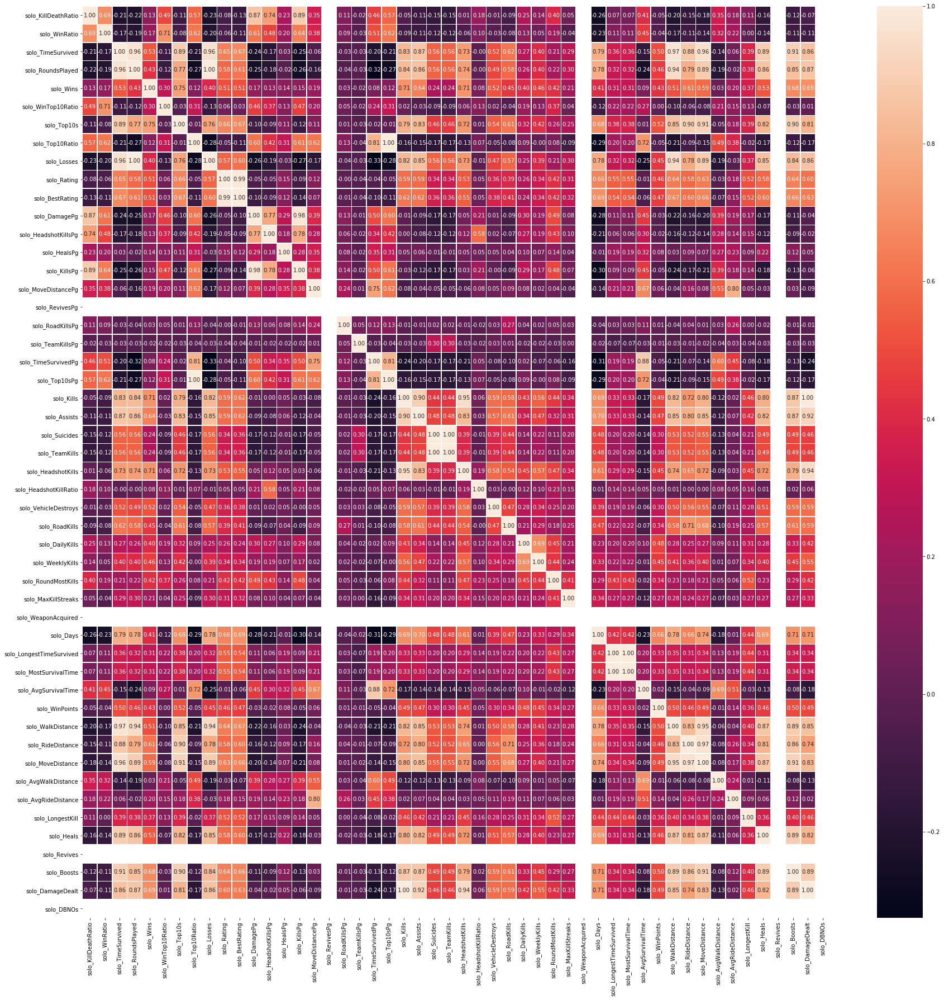

In [35]:
f,ax = plt.subplots(figsize=(30, 30))
sns.heatmap(df_solo.corr(), annot=True, linewidths=.5, fmt= '.2f',ax=ax)
plt.show()

In [38]:
fig = go.Figure()
fig.add_trace(go.Histogram(x=df_solo['solo_WalkDistance'], name='Solo Walk Distance'))
fig.add_trace(go.Histogram(x=df_solo['solo_RideDistance'], name='Solo Ride Distance'))

# The two histograms are drawn on top of another
fig.update_layout(barmode='stack')
fig.show()

In [43]:
df_solo.to_csv('solo_pubg_stats.csv', index=False)
print("Your solo dataset was successfully saved!")

Your solo dataset was successfully saved!


In [3]:
df_solo = pd.read_csv(r'E:\Machine Learning datasets\Pubg stats\solo_pubg_stats.csv')
df_solo.head()

,solo_KillDeathRatio,solo_WinRatio,solo_TimeSurvived,solo_RoundsPlayed,solo_Wins,solo_WinTop10Ratio,solo_Top10s,solo_Top10Ratio,solo_Losses,solo_Rating,...,solo_RideDistance,solo_MoveDistance,solo_AvgWalkDistance,solo_AvgRideDistance,solo_LongestKill,solo_Heals,solo_Revives,solo_Boosts,solo_DamageDealt,solo_DBNOs
0,3.14,17.65,18469.14,17,3,0.83,4,23.5,14,1559.78,...,27537.53,56461.84,2202.40,2764.50,304.87,33,0,29,4341.06,0
1,4.41,18.18,33014.86,33,6,0.36,11,33.3,27,1884.53,...,117837.74,165706.51,2017.38,5188.69,351.95,60,0,88,12970.39,0
2,3.60,0.00,4330.44,5,0,0.00,1,20.0,5,1255.92,...,7683.20,14023.99,1375.70,3052.50,125.76,5,0,3,1648.82,0
3,14.00,50.00,13421.82,8,4,0.67,6,75.0,4,1798.70,...,30314.83,47894.53,2197.46,3789.35,412.25,8,0,24,6015.57,0
4,10.50,33.33,9841.04,6,2,0.40,5,83.3,4,1668.67,...,22425.36,39161.77,2789.40,3737.56,307.97,12,0,21,3824.89,0


In [5]:
fig = go.Figure()
fig.add_trace(go.Histogram(x=df_solo['solo_WalkDistance'], name='Solo Walk Distance'))
fig.add_trace(go.Histogram(x=df_solo['solo_RideDistance'], name='Solo Ride Distance'))
fig.add_trace(go.Histogram(x=df_solo['solo_MoveDistance'], name='Solo Move Distance'))

# The two histograms are drawn on top of another
fig.update_layout(barmode='stack')
fig.show()

Here we can see that Move distance covers both ride and walk distance fairly well, and their co relation is also more tha 95% from the heatmap above so we can totally drop the walk and ride distance, their role can be played only by the move distance

In [6]:
df_solo.drop(['solo_RideDistance', 'solo_WalkDistance'], axis=1, inplace=True)

In [7]:
df_solo.columns

Index(['solo_KillDeathRatio', 'solo_WinRatio', 'solo_TimeSurvived',
       'solo_RoundsPlayed', 'solo_Wins', 'solo_WinTop10Ratio', 'solo_Top10s',
       'solo_Top10Ratio', 'solo_Losses', 'solo_Rating', 'solo_BestRating',
       'solo_DamagePg', 'solo_HeadshotKillsPg', 'solo_HealsPg', 'solo_KillsPg',
       'solo_MoveDistancePg', 'solo_RevivesPg', 'solo_RoadKillsPg',
       'solo_TeamKillsPg', 'solo_TimeSurvivedPg', 'solo_Top10sPg',
       'solo_Kills', 'solo_Assists', 'solo_Suicides', 'solo_TeamKills',
       'solo_HeadshotKills', 'solo_HeadshotKillRatio', 'solo_VehicleDestroys',
       'solo_RoadKills', 'solo_DailyKills', 'solo_WeeklyKills',
       'solo_RoundMostKills', 'solo_MaxKillStreaks', 'solo_WeaponAcquired',
       'solo_Days', 'solo_LongestTimeSurvived', 'solo_MostSurvivalTime',
       'solo_AvgSurvivalTime', 'solo_WinPoints', 'solo_MoveDistance',
       'solo_AvgWalkDistance', 'solo_AvgRideDistance', 'solo_LongestKill',
       'solo_Heals', 'solo_Revives', 'solo_Boosts', 'so

In [10]:
px.scatter(df_solo, x="solo_Heals", y="solo_Boosts", color="solo_Wins",
                 title="Wins according to use of Boost and Heals")

For some part linear relation is been seen b/w heals and boost, as according to gameplays many players tend to use boost after a heal to increase the rate of healing, and if the boost remains during that time they can also get healed by less damages(not by headshot or grenade or heavy firing)